## Wavelets With plotly

The Wavelet is defined by $y = exp(i(2\pi ft + \theta))exp(\frac{-4log(2)t^2}{w^2})$ where $f=5, w=0.5, i=\sqrt{-1}, \theta \in (2, 2\pi)$

In [1]:
import numpy as np
import matplotlib.pyplot as plt
# Plotly is quite complicated, matplotlib.animaion is simpler
#! pip install plotly
import plotly.graph_objects as go
import matplotlib.animation as animation
from matplotlib import rc
rc("animation",html="jshtml")

In [2]:
def createComplexWavelet(time, freq, fwhm, phs=0):
    sinepart = np.exp(1j*(2*np.pi*freq*time + phs))
    gauspart = np.exp((-4*np.log(2)*time**2)/(fwhm**2))
    
    return sinepart*gauspart

In [3]:
# Create and visualize 1 wavelet
freq = 5
fwhm = 0.5
srate = 500 #Hz
time = np.arange(-2*srate, 2*srate)/srate

wavelet = createComplexWavelet(time, freq, fwhm, phs=0)

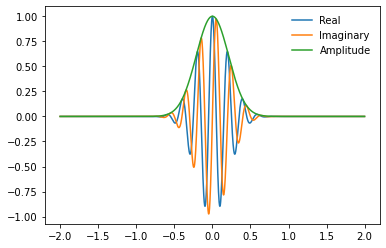

In [4]:
plt.plot(time, np.real(wavelet), label = "Real")
plt.plot(time, np.imag(wavelet), label = "Imaginary")
plt.plot(time, np.abs(wavelet), label = "Amplitude")
plt.legend(frameon = False)
plt.show()

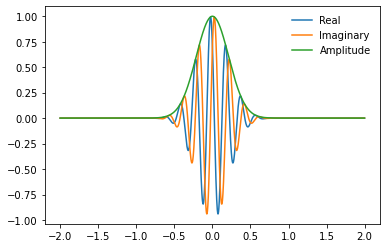

In [5]:
wavelet = createComplexWavelet(time, freq, fwhm, phs=np.pi/4)
plt.plot(time, np.real(wavelet), label = "Real")
plt.plot(time, np.imag(wavelet), label = "Imaginary")
plt.plot(time, np.abs(wavelet), label = "Amplitude")
plt.legend(frameon = False)
plt.show()

In [6]:
# Lets make an animation with plotly
fig = go.Figure(
    
    # 'data' sets the initial graph data
    data = [ go.Scatter(x=time, y=np.real(createComplexWavelet(time,freq,fwhm)),mode='lines') ],
    
    # layout defines the figure layout
    layout = go.Layout(updatemenus = [dict(type  = 'buttons',
                                         buttons = [ {'label':'Play', 
                                                      'method':'animate', 'args':[None]}  ])]   ),
    
    # frames is a list of movie frames
    frames = [go.Frame(data=[go.Scatter(x=time, y=np.real(createComplexWavelet(time,freq,fwhm,np.pi/6)))]),
              go.Frame(data=[go.Scatter(x=time, y=np.real(createComplexWavelet(time,freq,fwhm,np.pi/4)))]),
              go.Frame(data=[go.Scatter(x=time, y=np.real(createComplexWavelet(time,freq,fwhm,np.pi/3)))]) ]
)

fig.show()

## Create Wavelet: Part 2

In [7]:
# Create the figure as a Dictionary
gofigure = {
    'data': [ go.Scatter(x=time, y=np.real(createComplexWavelet(time,freq,fwhm)),name='Real part'),
              go.Scatter(x=time, y=np.imag(createComplexWavelet(time,freq,fwhm)),name='Imag part')],
    
    'layout': go.Layout(updatemenus = [dict(type='buttons',
                        buttons     = [ {'label':'Play', 'method':'animate','args':[None]}])],
                        title = 'Complex Morlet wavelet'
                        ),
    
    'frames': [] # Will use for loop to create instances to be appended to the list
}


In [8]:
# create frames
phases = np.linspace(0,2*np.pi,10)
for theta in phases:
  frames  = {'data':[]}
  tmpdct1 = {'x':time, 'y':np.real(createComplexWavelet(time,freq,fwhm,theta))}
  tmpdct2 = {'x':time, 'y':np.imag(createComplexWavelet(time,freq,fwhm,theta))}
  frames['data'].append(tmpdct1)
  frames['data'].append(tmpdct2)
  gofigure['frames'].append(frames)

fig = go.Figure(gofigure)
fig.show()

## Wavey Waveelts in Matplotlib

In [9]:
def createComplexWavelet(time, freq, fwhm, phs=0):
    sinepart = np.exp(1j*(2*np.pi*freq*time + phs))
    gauspart = np.exp((-4*np.log(2)*time**2)/(fwhm**2))
    
    return sinepart*gauspart

In [10]:
# Default Wavelet parameters
freq = 5
fwhm = 0.5
srate = 500 #Hz
time = np.arange(-2*srate, 2*srate)/srate

In [11]:
def aframe(phs):
    
    # Create a new wavelet
    wavelet = createComplexWavelet(time, freq, fwhm, phs)
    
    # Update the plot
    plth1.set_ydata(np.real(wavelet))
    plth2.set_ydata(np.imag(wavelet))
    
    return (plth1, plth2)

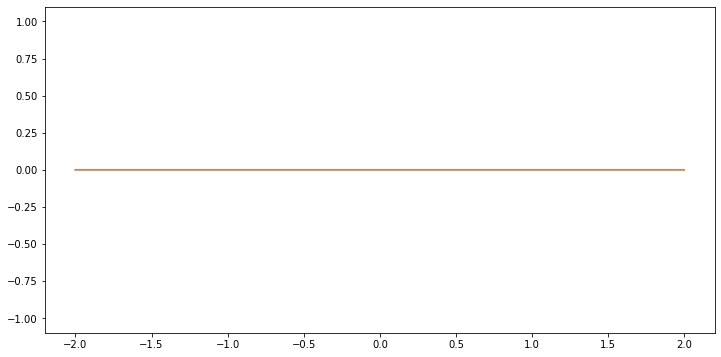

In [12]:
# Set up a figure
fig,ax = plt.subplots(1, figsize=(12,6))

plth1, = ax.plot(time, np.zeros(len(time)))
plth2, = ax.plot(time, np.zeros(len(time)))
ax.set_ylim([-1.1,1.1])
# create an animation object
phases = np.linspace(0,2*np.pi-2*np.pi/10,10)
# Change parameters
ani = animation.FuncAnimation(fig, aframe, phases, interval=100,repeat=True)

In [13]:
ani

## Mobius Transform in Matplotlib

Mobius Transform Equation: $f = \frac{(t-1)+(1+t)z}{(t+1)+(1-t)z}$ where $z=a+ib, t \in (0.2,2)$, and  $a,b \in (-40,40)$

In [14]:
# Parameters and initializations

a = np.linspace(-40,40,80)
b = np.linspace(-40,40,80)

mobtrans = np.zeros((len(a), len(b)),dtype=complex)
ts = np.linspace(0.2,2,100)

# Function that draws each frame
def aframe(t):
    # create the mobious Image
    for i,aa in enumerate(a):
        for j,bb in enumerate(b):
            z = complex(aa,bb)
            # Create a mobius image
            num = (t-1) + (t+1)*z
            den = (t+1) + (t-1)*z
    
            mobtrans[i,j] = num/den
    # Update the Figure
    imh[0].set_data(np.real(mobtrans))
    imh[1].set_data(np.imag(mobtrans))
    imh[2].set_data(np.abs(mobtrans))
    return imh

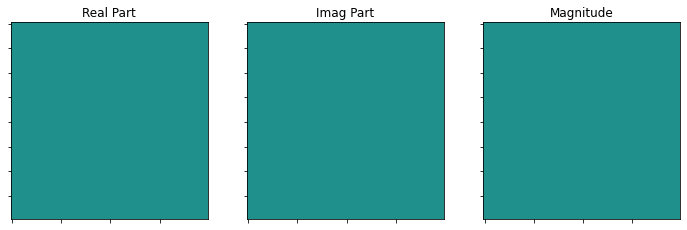

In [15]:
fig,axs = plt.subplots(1,3, figsize=(12,8))
imh = [0]*3
imh[0] = axs[0].imshow(np.zeros((len(a), len(b))),vmin=-50,vmax=50)
imh[1] = axs[1].imshow(np.zeros((len(a), len(b))),vmin=-50,vmax=50)
imh[2] = axs[2].imshow(np.zeros((len(a), len(b))),vmin=-50,vmax=50)

for i in range(3):
    axs[i].tick_params(labelbottom=False, labelleft=False)

axs[0].set_title("Real Part")
axs[1].set_title("Imag Part")
axs[2].set_title("Magnitude")

ani = animation.FuncAnimation(fig,aframe,ts,interval=50)

In [16]:
ani

In [17]:
# Export GIF as a file
writergif = animation.PillowWriter(fps=30)
ani.save("Mobius.gif", writer=writergif)

## The Wandering Prime

First, find the prime numbers between 2 and N, and then loop over the primes:

1 - Compute the distance of each prime number to from previous prime

2 - Travel that distance

3 - Rotate direction 90 degrees clockwise

In [18]:
from sympy import isprime

n = 100000

ps = [ i for i in range(n) if isprime(i) ]

In [19]:
len(ps)

9592

In [20]:
d = np.arange(14)
(d+1)%4

array([1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2])

In [21]:
# Initialize the matrix
xy = np.zeros((len(ps),2))
direction = 0

for i in range(1,len(ps)):
    
    # Calculate the Distance
    dist = ps[i] - ps[i-1]
    
    # Update the xy coordinate
    if direction == 0:
        xy[i,:] = [xy[i-1,0],xy[i-1,1]+dist]
    elif direction==1:
        xy[i,:] = [xy[i-1,0]+dist,xy[i-1,1]]
    elif direction==2:
        xy[i,:] = [xy[i-1,0],xy[i-1,1]-dist]
    elif direction==3:
        xy[i,:] = [xy[i-1,0]-dist,xy[i-1,1]]
    
    # Update direction variable
    direction = (direction+1)%4

In [22]:
xy

array([[  0.,   0.],
       [  0.,   1.],
       [  2.,   1.],
       ...,
       [344., 789.],
       [362., 789.],
       [362., 787.]])

In [23]:
# Mean center to get the image at the center of the graph
xy -= np.mean(xy,axis=0)

In [24]:
np.mean(xy,axis=0)

array([ 2.24754327e-13, -5.71960235e-12])

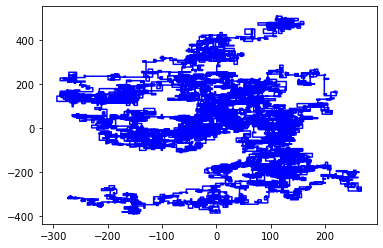

In [25]:
plt.plot(xy[:,0],xy[:,1], "b");

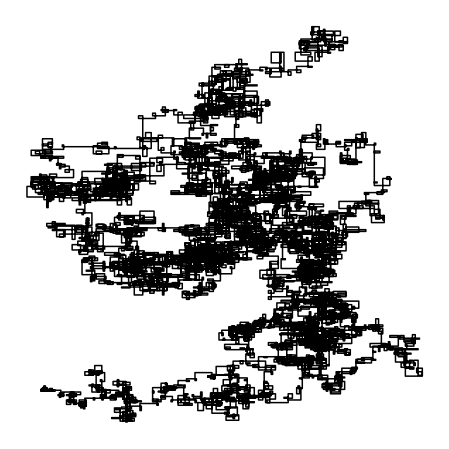

In [26]:
# Create an animation

# function to draw the plots
def aframe(i):
    ph.set_xdata(xy[:i,0])
    ph.set_ydata(xy[:i,1])
    return ph

# setup the image
fig,ax = plt.subplots(1,figsize=(8,8))
ph, = ax.plot(xy[:,0],xy[:,1],'k')
ax.set_aspect(1./ax.get_data_ratio())
ax.axis('off')

# and create the animation!
frameskip = 50
ani = animation.FuncAnimation(fig, aframe, range(0,len(xy),frameskip))
ani